# Query-by-humming model tutorial


In [1]:
# move working directory to /qbh_project
%cd ..
%pwd

/home/svcapp/userdata/dev/qbh_project


'/home/svcapp/userdata/dev/qbh_project'

In [2]:
%load_ext autoreload
%autoreload 2

import pickle
import pandas as pd
import numpy as np
from pathlib import Path
import IPython.display as ipd
from pydub import AudioSegment
import matplotlib.pyplot as plt
import random
import utils.monitoring as monitoring

from utils.sampling_utils import downsample_contour_array


import builtins
from IPython.lib import deepreload
builtins.reload = deepreload.reload


## 0. Metadata of DB

Meta data is saved as a list of dictionary.
Each item in the list represents a single track.


- db_metadata: database consists of music100k + music120k
- humm_test_meta: database consists of 100 pieces selected by FLO

Caution: 'track_id' is the one corresponds to actual file name, not a 'song_id'.
Since the provided metadata for each dataset is different, dictionary key for each metadata set is different from each other.


Belows are the list of genre name and the corresponding id. + sign represents that the genre was included during the QbH model training

- 해외 메탈 18
- 국내 발라드 4 +
- 해외 힙합 14
- 기타 30
- 클래식 20
- 재즈 22
- 국내 락/메탈 12 + 
- 해외 팝 13 + 
- 월드뮤직 26
- 해외 락 17 + 
- J-POP 25
- 뉴에이지 21
- 국내 알앤비 7 + 
- CCM 28
- 해외 알앤비 15 + 
- 맘/태교 24
- OST/BGM 19
- 국내 댄스/일렉 5
- 해외 일렉트로닉 16
- 트로트 8
- 국내 포크/블루스 11 + 
- 키즈 23
- 국내 인디 9 +
- 종교음악 29
- 국악 27
- 국내 팝/어쿠스틱 10 +
- 국내 힙합 6

In [3]:
with open("data/flo_metadata_220k.dat", 'rb') as f:
    db_metadata = pickle.load(f)

humm_test_meta = pd.read_csv('data/flo_test_list.csv').to_dict('records')

# print first track as an example
print("1. db_metadata example:", db_metadata[0])
print("2. flo_test_metadata example:", humm_test_meta[0])

1. db_metadata example: {'song_id': 427675419, 'artist_id_basket': [80141499], 'artist_name_basket': ['AKMU (악동뮤지션)'], 'album_id': 403299537, 'album_name': '항해', 'track_id': 427675419, 'track_name': '어떻게 이별까지 사랑하겠어, 널 사랑하는 거지', 'label_name_basket': ['YG Entertainment'], 'genre_id_basket': [4], 'genre_name_basket': ['국내 발라드'], 'publish_date': 20190925, 'play_count': 13161405}
2. flo_test_metadata example: {'곡명': 'You Give Me Something', '아티스트명': 'James Morrison', '해당 요건': 'CF', '비고': 'KTX 광고', 'url': 'https://www.music-flo.com/detail/track/hdnzyzeh/details', 'track id': 80269648}


## 1. Melody data from audio file

"Melody" of music is extracted using singing voice estimation model.
The result is saved in txt format.

This section demonstrates how the result is formatted

In [4]:
# define dataset path
dataset_dir = Path('/home/svcapp/t2meta/flo_new_music/music_100k/')
# define target genre
# selected_genres = [4]
selected_genres = [4, 12, 13, 17, 10, 7,15, 11, 9]

In [5]:
from utils.melody_utils import MelodyLoader
from utils.data_utils import get_song_ids_of_selected_genre, song_id_to_pitch_txt_path

### Get a list of song id and corresponding pitch path

In [6]:
song_ids = get_song_ids_of_selected_genre(db_metadata, selected_genres)
with open('data/humm_db_ids.dat', 'rb') as f:
    humm_ids = pickle.load(f)
song_ids += humm_ids
melody_loader = MelodyLoader(dataset_dir)
melody_loader.check_txt_exists(song_ids, make_txt=False) # Set make_txt=True to make txt


/home/svcapp/.local/lib/python3.6/site-packages/torch/nn/modules/rnn.py:51: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  "num_layers={}".format(dropout, num_layers))
Check passed: Every song has corresponding txt


#### The following shows the example of windowed melody.

- melody_of_piece: list of dict
    - 'contour': numpy array of contour
    - 'song_id': 'track_id' of the song
    - 'frame_pos': slice position in 10ms

In [7]:
# can select any index < len(song_ids)
index = 0 
target_song_id = song_ids[index]
melodies_of_piece = melody_loader(target_song_id)
print(melodies_of_piece[0])

{'contour': array([[0., 0.],
       [0., 0.],
       [0., 0.],
       ...,
       [0., 0.],
       [0., 0.],
       [0., 0.]]), 'song_id': 427675419, 'frame_pos': (13000, 15000)}


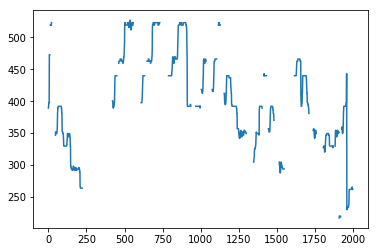

In [26]:
# Monitor data with plot graph and audio
melody_idx = random.randint(0, len(melodies_of_piece)-1)
selected_melody = melodies_of_piece[melody_idx]

# The contour was converted into log scale and then normalized with mean/std
# Therefore, this process 
contour_in_hz_scale = np.copy(selected_melody['contour']) 
contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_melody['contour'])
monitoring.plot_contour_with_voice_only(contour_in_hz_scale)

orig_audio, contour_audio = monitoring.get_audio_and_sine_from_contour_data(selected_melody, dataset_dir)
ipd.display(ipd.Audio(orig_audio, rate=44100))
ipd.display(ipd.Audio(contour_audio, rate=44100))
ipd.display(ipd.Audio((orig_audio+contour_audio)/2, rate=44100))


## 2. Humming data from HummingDB
- HummingDB consists of humming audio and metadata
- "Spec.xlsx" includes metadata of humming audio
- 900 songs were selected from flo_metadata.dat (original music_100k dataset)
- 100 songs were selected by FLO
- Since we don't have detailed metadata for 100 songs selected by FLO, meta format is slightly different.

In [9]:
humming_data_dir = Path('/home/svcapp/userdata/humming_db')

In [10]:
import utils.humming_data_utils as humming

selected_100, selected_900 = humming.load_meta_from_excel(xlsx_path=humming_data_dir/"Spec.xlsx", meta_path="data/flo_metadata_220k.dat", meta_100_path='data/meta_100.dat')
humming_db = humming.HummingDB(humming_data_dir, dataset_dir, selected_100, selected_900)


In [11]:
# Print example
humming_db[0]

{'humm': array([[0., 0.],
        [0., 0.],
        [0., 0.],
        ...,
        [0., 0.],
        [0., 0.],
        [0., 0.]]), 'orig': array([[-1.19150787,  1.        ],
        [-1.19150787,  1.        ],
        [-1.19150787,  1.        ],
        ...,
        [ 0.66531312,  1.        ],
        [ 0.66531312,  1.        ],
        [ 0.66531312,  1.        ]]), 'meta': {'path': '/home/svcapp/userdata/humming_db/100/0~24/01_P/100_0_A_105-125_(PF_KRJ).wav',
  'pitch_path': '/home/svcapp/userdata/humming_db/100/0~24/01_P/100_0_A_105-125_(PF_KRJ).f0.csv',
  'song_group': '100',
  'song_idx': '0',
  'humming_type': 'A',
  'time_stamp': '105-125',
  'singer_group': 'P',
  'singer_id': 'KRJ',
  'singer_gender': 'F',
  'track_id': 80269648}}

- 'humm': array of humming melody. Time resolution is 10 ms
- 'orig': array of original melody, extracted from original recording by automatic singing voice estimator. Time resolution is 10 ms. The slice position was selected based on 'meta'-'time_stamp'
- 'meta': metadata of humming sample.
    - 'path': path to humming audio
    - 'pitch_path': path to f0 curve extracted from humming audio by crepe algorithm.
    - 'song_group': '100' or '900',
    - 'song_idx': song idx in humming list
    - 'humming_type': 'A' for mouth-closed humming, 'B' for humming with A vowel, 'C' for singing with lyric, 'D' for freely selected by singer
    - 'time_stamp': str(A-B) that represents time stamp of humming in original audio, in seconds. Notated by the singer.
    - 'singer_group': 'P' for professional, 'N' for non-professional
    - 'singer_id': initial of singer name
    - 'singer_gender': 'M' or 'F'
    - 'track_id': track_id of the corresponding original song
    


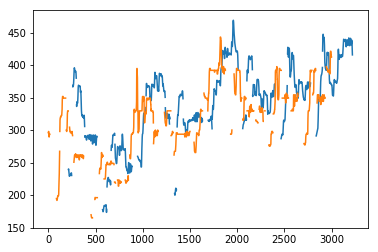

In [15]:
# Monitor data with plot graph and audio
melody_idx = random.randint(0, len(humming_db)-1)
selected_humm_pair = humming_db[melody_idx]

# The contour was converted into log scale and then normalized with mean/std
# Therefore, this process 
contour_in_hz_scale = np.copy(selected_humm_pair['humm']) 
contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_humm_pair['humm'])
monitoring.plot_contour_with_voice_only(contour_in_hz_scale)

orig_contour_in_hz_scale = np.copy(selected_humm_pair['orig'])
orig_contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_humm_pair['orig'])
monitoring.plot_contour_with_voice_only(orig_contour_in_hz_scale)


humm_audio, orig_audio, humm_contour_audio, orig_contour_audio = monitoring.get_audio_and_sine_from_humming_pair(selected_humm_pair, dataset_dir)
ipd.display(ipd.Audio(humm_audio, rate=44100))
ipd.display(ipd.Audio(orig_audio, rate=44100))
ipd.display(ipd.Audio(humm_contour_audio, rate=44100))
ipd.display(ipd.Audio(orig_contour_audio, rate=44100))



## 3. QbH Model

QbH model takes melody input and embed it into a 512-dim vector.

- Input is a tensor of B x N x 2.
- B is number of batch.
- N is number of frames in 100 ms. (The original txt or csv file has melody in 10 ms. Therefore, the melody has to be downsampled before feeding it into QbH model)
- Output is a tensor of B x 512

In [24]:
from test_qbh import load_model
from model import hparams
import torch
model_dir = Path('/home/svcapp/t2meta/qbh_model')
model_id = 485391
ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))
device = 'cuda'

encoder_model, hparams = load_model(ckpt_dir, device=device)

Loading checkpoint '/home/svcapp/t2meta/qbh_model/worker_485391_contour_scheduled_hidden256_lr0.0001_210411-053630/checkpoint_best.pt'
Loading checkpoint '/home/svcapp/t2meta/qbh_model/worker_485391_contour_scheduled_hidden256_lr0.0001_210411-053630/checkpoint_best.pt'
Loaded checkpoint '/home/svcapp/t2meta/qbh_model/worker_485391_contour_scheduled_hidden256_lr0.0001_210411-053630/checkpoint_best.pt' from iteration 300001


In [27]:
# contour has to be downsampled from 10ms resolution to 100ms resolution (10-to-1 downsample)
contour = downsample_contour_array(selected_melody['contour'])

# change contour as a tensor of Batch X Length X 2
contour_tensor = torch.Tensor(contour).unsqueeze(0).to(device)

# get_embedding:
contour_embedding = encoder_model(contour_tensor)
print(contour_embedding.shape, contour_embedding)

torch.Size([1, 512]) tensor([[-0.0630,  0.0417, -0.0154, -0.0312, -0.0411,  0.0460, -0.0126, -0.0185,
         -0.0379, -0.0464,  0.0093, -0.0579, -0.0865, -0.0238, -0.0665, -0.0365,
          0.0545,  0.0627,  0.0138,  0.0154, -0.0380,  0.0259,  0.0663,  0.0583,
         -0.0254, -0.0973,  0.0709, -0.0128, -0.0313,  0.0364, -0.0149,  0.0023,
          0.0143,  0.0407, -0.0473,  0.0190, -0.0212, -0.0717, -0.0456, -0.0113,
         -0.0366, -0.0312,  0.0031,  0.0254,  0.0288, -0.0288,  0.0171, -0.0292,
          0.0060,  0.0267, -0.0406, -0.0712, -0.0440,  0.0266, -0.0244, -0.0065,
          0.0610,  0.0562,  0.0006, -0.0208, -0.0586,  0.0451, -0.0040,  0.0288,
          0.0450, -0.0353, -0.0242,  0.0444, -0.0489,  0.0203, -0.0344, -0.0321,
          0.0026, -0.0145, -0.0023,  0.0028,  0.0605,  0.0360, -0.0088,  0.0066,
          0.0102, -0.0233, -0.0049,  0.0356,  0.0350, -0.0267, -0.0211, -0.0511,
          0.0052, -0.0121,  0.0342,  0.0515, -0.0329, -0.0258,  0.0492, -0.0842,
       

## 4 Training
### 4-1 Training Dataset and Data Augmentation


- humming_db_contour_pairs.dat was generated by humming_data_utils.py

In [29]:
from train import prepare_dataloaders, prepare_entire_loader, prepare_humming_db_loaders
from hparams import HParams

# Pre-defined hparams can be loaded from load_model.
# Otherwise, you can define new one with following 
# hparams = HParams()
hparams.meta_path = 'data/flo_metadata_220k.dat'
hparams.humming_path = '/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat'
hparams.data_dir = dataset_dir
hparams.batch_size = 64
hparams.valid_batch_size = 128
hparams.end_to_end = False

# Load entire_loader, which includes every song in the database for selected genre
# num_song_limit is just for testing with small dataset
# add_humm=True add songs that are included in HummingDB to the entire_loader. If not, we cannot search song with a humming query because the song is not included in the dataset
entire_loader = prepare_entire_loader(hparams, num_song_limit=1000, add_humm=True)
train_loader, val_loader = prepare_dataloaders(hparams, entire_loader)
humm_train_loader, humm_val_loader = prepare_humming_db_loaders(hparams)

- train_loader: 
    - load tensor from MelodyDB. 
    - Anchor is a melody from a song in MelodyDB
    - Positive samples are generated by melody augmentation of anchor melody.
    - Negative samples are from other piece of music (with different track_id)
- humm_train_loader: 
    - load tensor from HummingDB. 
    - Anchor is a f0 contour from a humming in HummingDB
    - Positive samples are original melody of the same song and its augmentation from Melody DB
    - Negative samples are from other piece of music (with different track_id)


- Batch Structure:
    - (Num Batch X (1 + num_positive_samples + num_negative_samples )) X max_length X 2
    - Can be resahped as Num Batch X (1 + num_positive_samples + num_negative_samples ) X max_length X 2
    - Order of sample in batch is as below:
        - 0th melody anchor
        - 0th melody 0th positive sample
        - 0th melody 1st positive sample
        - ...
        - 0th melody (n_pos)th positive sample
        - 0th melody 0th negative sample
        - 0th melody 1st neagtive sample
        - ...
        - 0th melody (n_neg)th negative sample
        - 1st melody anchor
        - ...


In [30]:
train_loader_sample = next(iter(train_loader))
humm_loader_sample = next(iter(humm_train_loader))

print(train_loader_sample.shape) # (Num_Batch X (1 + num_pos + num_neg)) X max_length X 2
print(humm_loader_sample.shape) # (Num_Batch X (1 + num_pos + num_neg)) X max_length X 2

torch.Size([1088, 312, 2])
torch.Size([1088, 651, 2])


### Monitoring data augmentation
- Anchor sample is an automatically-extracted melody 
- Positive samples are augmented version of anchor sample
    - pitch shift
    - tempo change
    - voice fill in
    - pitch noise
    - tempo noise
    - masking
- Negative samples are melody from songs with different track_id

#### The plot below shows example of Anchor, Positive sample, Negative sample

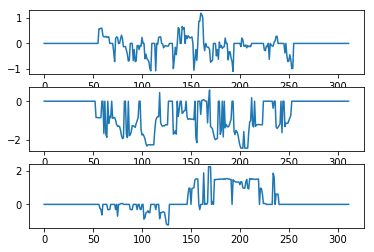

In [63]:
example_id = 0
example_of_single_pair = train_loader_sample.view(-1, 1+train_loader.dataset.num_aug_samples+train_loader.dataset.num_neg_samples, train_loader_sample.shape[1], train_loader_sample.shape[2])[example_id]
anchor = example_of_single_pair[0]
first_pos = example_of_single_pair[1]
first_neg = example_of_single_pair[1+train_loader.dataset.num_aug_samples]

fig = plt.figure()
fig.add_subplot(3,1,1)
plt.plot(anchor[:,0])
fig.add_subplot(3,1,2)
plt.plot(first_pos[:,0])
fig.add_subplot(3,1,3)
plt.plot(first_neg[:,0])

anchor_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(anchor.numpy()), frame_rate=10, sr=44100)
pos_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(first_pos.numpy()), frame_rate=10, sr=44100)
neg_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(first_neg.numpy()), frame_rate=10, sr=44100)

ipd.display(ipd.Audio(anchor_wav, rate=44100))
ipd.display(ipd.Audio(pos_wav, rate=44100))
ipd.display(ipd.Audio(neg_wav, rate=44100))

### Visualization Anchor-Pos-Neg pair in t-SNE 

- Each circle represents anchor embedding
- Green line represents a distance between the anchor and a positive sample
- Red line represents a distance between the anchor and a negative sample

In [79]:
from sklearn.manifold import TSNE
batch =train_loader_sample.cuda()
with torch.no_grad():
    anchor, pos, neg = encoder_model(batch, siamese=True)

embed_cat = torch.cat([anchor, pos, neg], dim=1)
tsne_embedded = TSNE(n_components=2).fit_transform(embed_cat.view(-1,512).cpu().numpy())


KeyboardInterrupt: 

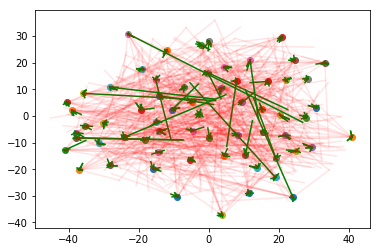

In [82]:
num_pos_samples = pos.shape[1]
num_neg_samples = neg.shape[1]
num_emb_per_melody = 1+num_pos_samples+num_neg_samples

for i in range(anchor.shape[0]):
    anchor_id = i*num_emb_per_melody
    plt.scatter(tsne_embedded[anchor_id,0], tsne_embedded[anchor_id,1])
    for j in range(num_pos_samples):
        plt.plot( [tsne_embedded[anchor_id,0], tsne_embedded[anchor_id+j+1,0]], [tsne_embedded[anchor_id,1], tsne_embedded[anchor_id+j+1,1]], c='g' )
    for j in range(num_neg_samples):
        plt.plot( [tsne_embedded[anchor_id,0], tsne_embedded[anchor_id+j+num_pos_samples+1,0]], [tsne_embedded[anchor_id,1], tsne_embedded[anchor_id+j+num_pos_samples+1,1]], alpha=0.1, c='r')

### Train Loop for jupyter
(The full train loop is in train.py)


In [34]:

from model.loss_function import SiameseLoss
from torch.optim.lr_scheduler import StepLR

target_iter = 100
iteration = 0

encoder_model.train()
optimizer = torch.optim.Adam(encoder_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
scheduler = StepLR(optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
criterion = SiameseLoss(margin=hparams.loss_margin, use_euclid=hparams.use_euclid, use_elementwise=hparams.use_elementwise_loss)
iterative_loader = iter(train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    encoder_model.zero_grad()
    batch = batch.cuda()
    anchor, pos, neg = encoder_model(batch, siamese=True)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(encoder_model.parameters(), hparams.grad_clip_thresh)
    optimizer.step()
    scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1


iter_0 Loss: 0.08516693115234375
iter_1 Loss: 0.06129114329814911
iter_2 Loss: 0.04923655837774277
iter_3 Loss: 0.04541357234120369
iter_4 Loss: 0.043651215732097626
iter_5 Loss: 0.03705606609582901
iter_6 Loss: 0.034355416893959045
iter_7 Loss: 0.03842182084918022
iter_8 Loss: 0.039876788854599
iter_9 Loss: 0.031083185225725174
iter_10 Loss: 0.03402414545416832
iter_11 Loss: 0.03159994259476662
iter_12 Loss: 0.029238320887088776
iter_13 Loss: 0.028589626774191856
iter_14 Loss: 0.027803992852568626
iter_15 Loss: 0.024804670363664627
iter_16 Loss: 0.03299807757139206


KeyboardInterrupt: 

In [58]:
# Train with 

### Validation by data augmentation
- One of simple validation processes is to sample a melody from validset and search this melody by feeding augmented versions of it.
- The score shows how the NN is robust to melody augmentation

In [39]:
from model.validation import get_contour_embeddings, cal_mrr_of_loader

encoder_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(encoder_model, entire_loader)
    valid_score = cal_mrr_of_loader(encoder_model, val_loader, total_embs, total_song_ids)
print(valid_score)


0.9997897677951388


### Fine Tuning with humming data

In [40]:
from itertools import cycle 

target_iter = 20
iteration = 0

encoder_model.train()
fine_optimizer = torch.optim.Adam(encoder_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
fine_scheduler = StepLR(fine_optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
iterative_loader = cycle(humm_train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    encoder_model.zero_grad()
    batch = batch.cuda()
    anchor, pos, neg = encoder_model(batch, siamese=True)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(encoder_model.parameters(), hparams.grad_clip_thresh)
    fine_optimizer.step()
    fine_scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1

iter_0 Loss: 0.07526148855686188
iter_1 Loss: 0.06239135563373566
iter_2 Loss: 0.07029023766517639
iter_3 Loss: 0.054930247366428375
iter_4 Loss: 0.06120951473712921
iter_5 Loss: 0.07118068635463715
iter_6 Loss: 0.05720461159944534
iter_7 Loss: 0.048187289386987686
iter_8 Loss: 0.05847245454788208
iter_9 Loss: 0.05866248533129692
iter_10 Loss: 0.06989365071058273
iter_11 Loss: 0.06722959131002426
iter_12 Loss: 0.05910255014896393
iter_13 Loss: 0.04584888741374016
iter_14 Loss: 0.0921931117773056
iter_15 Loss: 0.030380509793758392
iter_16 Loss: 0.02435031160712242
iter_17 Loss: 0.028032615780830383
iter_18 Loss: 0.02864665910601616
iter_19 Loss: 0.031000765040516853


### Validation with humming data

In [41]:
encoder_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(encoder_model, entire_loader)
    valid_score = cal_mrr_of_loader(encoder_model, humm_val_loader, total_embs, total_song_ids)
print(valid_score)

0.8934889137744904


### Test with humming data

In [43]:
from test_qbh import evaluate, prepare_humming_testset, get_index_by_id, convert_result_to_dict, convert_result_to_rec_title

humm_test_loader = prepare_humming_testset('/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat', num_workers=4)

total_slice_pos = np.asarray([x['frame_pos'] for x in entire_loader.dataset.contours]) # Here we also record exact slice position

meta_in_song_key = {x['track_id']: x for x in db_metadata}
for song in selected_100.to_dict('records'):
    meta_in_song_key[song['track_id']] = song
for song in selected_900.to_dict('records'):
    meta_in_song_key[song['track_id']] = song
    
flo_test_list = pd.read_csv('data/flo_test_list.csv')
flo_test_meta = {x['track id']: x for x in flo_test_list.to_dict('records')}
humm_meta = [x['meta'] for x in humm_test_loader.dataset.contours]

#### During the test process, the search results are listed in a track-wise, not a melody-wise. 
Therefore, here we group melodies by track

In [45]:
# Group melodies by track
unique_ids, index_by_id = get_index_by_id(total_song_ids)

# calculate accuracy
topk_score, mrr_score, total_recommends, total_test_ids, total_rank, total_rec_slices, total_corresp_similarity = evaluate(encoder_model, humm_test_loader, total_embs, total_song_ids, unique_ids, index_by_id, total_slice_pos, top_k=10)

Top 10 accuracy: 0.728
MRR score:  0.6411190162145776


In [46]:
# make result readable
eval_out = convert_result_to_dict(total_test_ids, total_rank, meta_in_song_key)
detailed_eval_out = convert_result_to_rec_title(total_test_ids, total_recommends, total_rank, total_corresp_similarity, meta_in_song_key, humm_meta)

In [47]:
dataframe = pd.DataFrame(detailed_eval_out).transpose()
dataframe.insert(1, 'Class', [flo_test_meta[x]['해당 요건'] for x in dataframe[0].values])
dataframe = dataframe.sort_values('Class')
sorted_keys = dataframe.to_dict()[0].keys()
dataframe = dataframe.drop(columns=[0])
dataframe

,Class,1,2,3,4,5
민수 - 민수는 혼란스럽다,CF,Rec rank: 2\nSimilarity with Orig: 0.7335\nAli...,Rec rank: 1\nSimilarity with Orig: 0.8740\n민수 ...,Rec rank: 1\nSimilarity with Orig: 0.7334\n민수 ...,Rec rank: 18\nSimilarity with Orig: 0.6009\nMo...,Rec rank: 3\nSimilarity with Orig: 0.6742\nNCT...
Betty Who - Taste,CF,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...
Chantal Chamberland - La Mer,CF,Rec rank: 1\nSimilarity with Orig: 0.8184\nCha...,Rec rank: 1\nSimilarity with Orig: 0.7865\nCha...,Rec rank: 20\nSimilarity with Orig: 0.6116\n김연...,Rec rank: 1\nSimilarity with Orig: 0.8276\nCha...,Rec rank: 1\nSimilarity with Orig: 0.7125\nCha...
James Blake - Are You Even Real?,CF,Rec rank: 209\nSimilarity with Orig: 0.4960\nS...,Rec rank: 8\nSimilarity with Orig: 0.6700\nRen...,Rec rank: 27\nSimilarity with Orig: 0.6122\nSi...,Rec rank: 374\nSimilarity with Orig: 0.4054\n김...,Rec rank: 4\nSimilarity with Orig: 0.6796\n강다니...
김현철 - Drive,CF,Rec rank: 2\nSimilarity with Orig: 0.7299\nDav...,Rec rank: 1\nSimilarity with Orig: 0.9664\n김현철...,Rec rank: 1\nSimilarity with Orig: 0.8646\n김현철...,Rec rank: 4\nSimilarity with Orig: 0.6807\n4AL...,Rec rank: 2\nSimilarity with Orig: 0.7596\nDav...
HONNE - Warm On A Cold Night,CF,Rec rank: 142\nSimilarity with Orig: 0.3722\n김...,Rec rank: 2\nSimilarity with Orig: 0.7795\n반하나...,Rec rank: 24\nSimilarity with Orig: 0.5759\nBo...,Rec rank: 1\nSimilarity with Orig: 0.7951\nHON...,Rec rank: 1\nSimilarity with Orig: 0.7796\nHON...
"Pawl, Discrete - Type Like That",SNS,Rec rank: 136\nSimilarity with Orig: 0.5338\nS...,Rec rank: 1608\nSimilarity with Orig: 0.0329\n...,Rec rank: 1\nSimilarity with Orig: 0.7040\nPaw...,Rec rank: 1081\nSimilarity with Orig: 0.1605\n...,Rec rank: 1192\nSimilarity with Orig: 0.1782\n...
Maluma - Hawai,SNS,Rec rank: 21\nSimilarity with Orig: 0.6185\nAr...,Rec rank: 1\nSimilarity with Orig: 0.8792\nMal...,Rec rank: 3\nSimilarity with Orig: 0.8344\nMar...,Rec rank: 1\nSimilarity with Orig: 0.8446\nMal...,Rec rank: 5\nSimilarity with Orig: 0.8342\nCol...
Jawsh 685 & Jason Derulo - Savage Love (Laxed - Siren Beat),SNS,Rec rank: 1\nSimilarity with Orig: 0.8470\nJaw...,Rec rank: 1\nSimilarity with Orig: 0.7807\nJaw...,Rec rank: 2\nSimilarity with Orig: 0.6723\nGol...,Rec rank: 1\nSimilarity with Orig: 0.8428\nJaw...,Rec rank: 2\nSimilarity with Orig: 0.6835\n015...
Bag Raiders - Shooting Stars,SNS,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...,Rec rank: 1837\nSimilarity with Orig: -1.0000\...


In [88]:
from test_qbh import QbhSystem

# contour model
ckpt_dir = Path('weights/contour_model')

# end-to-end model
# model_id = 484078
# model_dir = Path('/home/svcapp/t2meta/end-to-end-qbh/')
# ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))

qbh_system = QbhSystem(ckpt_dir, 'emb_test/', 'cuda', audio_dir=dataset_dir, make_emb=True, song_ids=song_ids[:100])

Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loaded checkpoint 'weights/contour_model/checkpoint_best.pt' from iteration 300001
/home/svcapp/.local/lib/python3.6/site-packages/torch/nn/modules/rnn.py:51: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [97]:
qbh_system.get_rec_by_audio(humm_audio)

[{'artist': ['아이유 (IU)'],
  'title': 'Love poem',
  'song_id': 433090157,
  'slice_pos': [14500, 16500],
  'similarity': 0.6320382356643677},
 {'artist': ['V.O.S.'],
  'title': '잘 살고 있다',
  'song_id': 433713831,
  'slice_pos': [10500, 12500],
  'similarity': 0.5842944979667664},
 {'artist': ['폴킴'],
  'title': '마음',
  'song_id': 433711593,
  'slice_pos': [8000, 10000],
  'similarity': 0.5797996520996094},
 {'artist': ['AKMU (악동뮤지션)'],
  'title': '뱃노래',
  'song_id': 427675417,
  'slice_pos': [2000, 4000],
  'similarity': 0.5675069093704224},
 {'artist': ['폴킴'],
  'title': '커피 한 잔 할래요',
  'song_id': 3357985,
  'slice_pos': [20500, 22500],
  'similarity': 0.5603703856468201}]

In [96]:
selected_humm_pair['meta']

{'path': '/home/svcapp/userdata/humming_db/900/900_286_A_35-53.wav',
 'pitch_path': '/home/svcapp/userdata/humming_db/900/900_286_A_35-53.f0.csv',
 'song_group': '900',
 'song_idx': '286',
 'humming_type': 'A',
 'time_stamp': '35-53',
 'track_id': 434303364,
 'singer_gender': 'F',
 'singer_group': 'P',
 'singer_id': 'PSH'}

In [145]:
rec_result = qbh_system.get_rec_by_melody(torch.Tensor(selected_melody['contour']), k=5)

In [146]:
rec_result

[{'artist': ['AKMU (악동뮤지션)'],
  'title': '어떻게 이별까지 사랑하겠어, 널 사랑하는 거지',
  'song_id': 427675419,
  'slice_pos': [20500, 22500],
  'similarity': 0.5347782373428345},
 {'artist': ['아이유 (IU)'],
  'title': 'Love poem',
  'song_id': 433090157,
  'slice_pos': [20000, 22000],
  'similarity': 0.4465144872665405},
 {'artist': ['장덕철'],
  'title': '있어줘요',
  'song_id': 431381071,
  'slice_pos': [16500, 18500],
  'similarity': 0.4105551242828369},
 {'artist': ['엠씨더맥스 (M.C the MAX)'],
  'title': '처음처럼',
  'song_id': 434461927,
  'slice_pos': [16500, 18500],
  'similarity': 0.3867615759372711},
 {'artist': ['임재현'],
  'title': '조금 취했어 (Prod. 2soo)',
  'song_id': 427664823,
  'slice_pos': [11000, 13000],
  'similarity': 0.36750054359436035}]

In [126]:
qbh_system.db_meta[427675419]

{'song_id': 427675419,
 'artist_id_basket': [80141499],
 'artist_name_basket': ['AKMU (악동뮤지션)'],
 'album_id': 403299537,
 'album_name': '항해',
 'track_id': 427675419,
 'track_name': '어떻게 이별까지 사랑하겠어, 널 사랑하는 거지',
 'label_name_basket': ['YG Entertainment'],
 'genre_id_basket': [4],
 'genre_name_basket': ['국내 발라드'],
 'publish_date': 20190925,
 'play_count': 13161405}

In [100]:
torch.LongTensor([x['song_id'] for x in embs for _ in range(x['embedding'].shape[0])]).shape

torch.Size([378])

In [144]:
qbh_system.get_and_save_embedding(song_ids[:10], 'emb_test/')

# 5. End-to-end Model

In [54]:
model_id = 484078
model_dir = Path('/home/svcapp/t2meta/end-to-end-qbh/')
ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))
end_to_end_model, hparams = load_model(ckpt_dir)

STFT kernels created, time used = 0.1432 seconds
Loading checkpoint '/home/svcapp/t2meta/end-to-end-qbh/worker_484078_contour_scheduled_hidden256_lr0.0001_210331-083440/checkpoint_best.pt'
Loading checkpoint '/home/svcapp/t2meta/end-to-end-qbh/worker_484078_contour_scheduled_hidden256_lr0.0001_210331-083440/checkpoint_best.pt'
Loaded checkpoint '/home/svcapp/t2meta/end-to-end-qbh/worker_484078_contour_scheduled_hidden256_lr0.0001_210331-083440/checkpoint_best.pt' from iteration 1200000


In [55]:
hparams.meta_path = 'data/flo_metadata_220k.dat'
hparams.humming_path = '/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat'
hparams.data_dir = dataset_dir
hparams.batch_size = 2
hparams.valid_batch_size = 4

# Load entire_loader, which includes every song in the database for selected genre
# num_song_limit is just for testing with small dataset
# add_humm=True add songs that are included in HummingDB to the entire_loader. If not, we cannot search song with a humming query because the song is not included in the dataset
entire_loader = prepare_entire_loader(hparams, num_song_limit=1000, add_humm=True)


In [56]:
train_loader, val_loader = prepare_dataloaders(hparams, entire_loader)
humm_train_loader, humm_val_loader = prepare_humming_db_loaders(hparams)

In [57]:
target_iter = 100
iteration = 0

encoder_model.train()
optimizer = torch.optim.Adam(end_to_end_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
scheduler = StepLR(optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
criterion = SiameseLoss(margin=hparams.loss_margin, use_euclid=hparams.use_euclid, use_elementwise=hparams.use_elementwise_loss)
iterative_loader = iter(train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    end_to_end_model.zero_grad()
    audio_anchor, melody = batch
    audio_anchor = audio_anchor.to('cuda')
    melody = melody.to('cuda')
    anchor, pos, neg = end_to_end_model( (audio_anchor, melody), siamese=True, num_pos=train_loader.dataset.num_aug_samples)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(end_to_end_model.parameters(), hparams.grad_clip_thresh)
    optimizer.step()
    scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1


iter_0 Loss: 0.06640314310789108
iter_1 Loss: 0.05439629405736923
iter_2 Loss: 0.041590962558984756
iter_3 Loss: 0.04422072321176529
iter_4 Loss: 0.02447417564690113
iter_5 Loss: 0.06191591918468475
iter_6 Loss: 0.032586660236120224
iter_7 Loss: 0.21371735632419586
iter_8 Loss: 0.04187687486410141
iter_9 Loss: 0.004115876741707325
iter_10 Loss: 0.025724345818161964
iter_11 Loss: 0.09620213508605957
iter_12 Loss: 0.009942924603819847
iter_13 Loss: 0.028569286689162254
iter_14 Loss: 0.020877989009022713
iter_15 Loss: 0.008617743849754333
iter_16 Loss: 0.004265311639755964
iter_17 Loss: 0.08776801824569702
iter_18 Loss: 0.03486897796392441
iter_19 Loss: 0.014461744576692581
iter_20 Loss: 0.057992711663246155
iter_21 Loss: 0.049166880548000336
iter_22 Loss: 0.019107544794678688
iter_23 Loss: 0.017938388511538506
iter_24 Loss: 0.02096371352672577
iter_25 Loss: 0.021964993327856064
iter_26 Loss: 0.0038964964915066957
iter_27 Loss: 0.03973229229450226
iter_28 Loss: 0.03617523983120918
iter_29

### Validation with end-to-end model

In [58]:
end_to_end_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
    valid_score = cal_mrr_of_loader(end_to_end_model, val_loader, total_embs, total_song_ids)
print(valid_score)


0.6547323895269485


### Fine tuning end-to-end model with humming data

In [59]:
target_iter = 20
iteration = 0

end_to_end_model.train()
fine_optimizer = torch.optim.Adam(end_to_end_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
fine_scheduler = StepLR(fine_optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
iterative_loader = cycle(humm_train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    audio_anchor, melody = batch
    encoder_model.zero_grad()
    audio_anchor = audio_anchor.to('cuda')
    melody = melody.to('cuda')
    anchor, pos, neg = end_to_end_model( (audio_anchor, melody), siamese=True, num_pos=humm_train_loader.dataset.num_aug_samples)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(end_to_end_model.parameters(), hparams.grad_clip_thresh)
    fine_optimizer.step()
    fine_scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1

iter_0 Loss: 0.03582174330949783
iter_1 Loss: 0.006203827448189259
iter_2 Loss: 0.042896170169115067
iter_3 Loss: 0.021750984713435173
iter_4 Loss: 0.047345783561468124
iter_5 Loss: 0.011238199658691883
iter_6 Loss: 0.05942600592970848
iter_7 Loss: 0.044412750750780106
iter_8 Loss: 0.0024080246221274137
iter_9 Loss: 0.03567302227020264
iter_10 Loss: 0.1390605866909027
iter_11 Loss: 0.11585555970668793
iter_12 Loss: 0.019350020214915276
iter_13 Loss: 0.07986363768577576
iter_14 Loss: 0.0010027665412053466
iter_15 Loss: 0.020072299987077713
iter_16 Loss: 0.005513740703463554
iter_17 Loss: 0.03653598949313164
iter_18 Loss: 0.12914776802062988
iter_19 Loss: 0.04319167882204056


In [61]:
end_to_end_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
    valid_score = cal_mrr_of_loader(end_to_end_model, humm_val_loader, total_embs, total_song_ids)
print(valid_score)

0.27544293111737167


array([[ 5000,  7000],
       [ 5500,  7500],
       [ 6000,  8000],
       ...,
       [20500, 22500],
       [21000, 23000],
       [21500, 23500]])

In [ ]:
from test_qbh import prepare_dataset_for_test

entire_loader, humm_test_loader, meta_in_song_key = prepare_dataset_for_test(data_dir='/home/svcapp/t2meta/flo_new_music/music_100k/', use_audio=True)
total_slice_pos = np.asarray(entire_loader.dataset.slice_infos)

total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
unique_ids, index_by_id = get_index_by_id(total_song_ids)

topk_score, mrr_score, total_recommends, total_test_ids, total_rank, total_rec_slices, total_corresp_similarity = evaluate(end_to_end_model, humm_test_loader, total_embs, total_song_ids, unique_ids, index_by_id, total_slice_pos, top_k=10)

In [80]:
eval_out = convert_result_to_dict(total_test_ids, total_rank, meta_in_song_key)
detailed_eval_out = convert_result_to_rec_title(total_test_ids, total_recommends, total_rank, total_corresp_similarity, meta_in_song_key, humm_meta)

dataframe = pd.DataFrame(detailed_eval_out).transpose()
dataframe.insert(1, 'Class', [flo_test_meta[x]['해당 요건'] for x in dataframe[0].values])
dataframe = dataframe.sort_values('Class')
sorted_keys = dataframe.to_dict()[0].keys()
dataframe = dataframe.drop(columns=[0])
dataframe

RuntimeError: CUDA error: device-side assert triggered

In [ ]:
model_id = 484078
model_dir = Path('/home/svcapp/t2meta/end-to-end-qbh/')
ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))
hparam_path = ckpt_dir/'hparams.dat'
with open(hparam_path, 'rb') as f:
    hparams_ete = pickle.load(f)
hparams_ete.end_to_end = True
# with open(hparam_path, 'wb') as f:
#     pickle.dump(hparams_ete, f)

In [ ]:
sim_cpu = similarity.cpu()

In [ ]:
torch.Tensor([torch.max(sim_cpu[:,x]) for x in corresp_ids])

In [ ]:
test = torch.sum(sim_cpu - torch.Tensor([torch.max(sim_cpu[:,x]) for x in corresp_ids]).unsqueeze(1) > 0, dim=0)

In [ ]:
torch.mean(1/(test+1))